<a href="https://colab.research.google.com/github/rashid818/yolov8_food_det_custom_data/blob/main/yolov8_food_detection_conveyor_belt.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>


## Introduction: Food and Bottle Detection on Conveyor Belt Using YOLOv8
Our project focuses on leveraging YOLOv8 for real-time detection and counting of food and bottles on conveyor belts in factory production lines. With a custom dataset comprising 486 annotated images, we've fine-tuned the model to accommodate variations in orientation and positioning. Augmentations include 90-degree rotations and resizing to 640x640. Our goal is to enhance efficiency and quality control by accurately tracking and quantifying items as they move through the production process.

## Before you start

Let's make sure that we have access to GPU. We can use `nvidia-smi` command to do that. In case of any problems navigate to `Edit` -> `Notebook settings` -> `Hardware accelerator`, set it to `GPU`, and then click `Save`.

In [ ]:
!nvidia-smi

Wed May  1 18:15:26 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   50C    P8              10W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [ ]:
import os

/content


## Install YOLOv8


In [ ]:
# Pip install method (recommended)

!pip install ultralytics==8.0.196

from IPython import display
display.clear_output()

import ultralytics
ultralytics.checks()

Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 28.9/78.2 GB disk)


In [ ]:
from ultralytics import YOLO

from IPython.display import display, Image

In [ ]:
# prompt: code to mount with google drive

from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [ ]:
!mkdir {HOME}/datasets
%cd {HOME}/datasets

/content/datasets


## Upload zip file of dataset to google drive and unzip it here


In [ ]:
#!unzip /content/drive/MyDrive/convoyer\ belt\ data/convoyer\ belt\ dataset.zip
!unzip /content/drive/MyDrive/convoyer_belt_data/cbyolo8.zip

Archive:  /content/drive/MyDrive/convoyer_belt_data/cbyolo8.zip
 extracting: README.dataset.txt      
 extracting: README.roboflow.txt     
 extracting: data.yaml               
   creating: test/
   creating: test/images/
 extracting: test/images/00034_jpg.rf.3941bc3857a119fc66496f9ce7e255bd.jpg  
 extracting: test/images/00063_jpg.rf.d01f7e143687d53ece98c66b26810f49.jpg  
 extracting: test/images/00076_jpg.rf.3202f329a37ab5bc9ab6d057a99301e6.jpg  
 extracting: test/images/c25_jpg.rf.0efe50b567016416c01838b287be5708.jpg  
 extracting: test/images/c29_jpg.rf.c1bf626d765943823cea3b7ae24bb00a.jpg  
 extracting: test/images/c32_jpg.rf.660e348412688fb7345803cc5e64c4c5.jpg  
 extracting: test/images/check_original_c1-jpg_42e05e94-1bdc-4a15-81fa-ca9747c8d016_jpg.rf.0f59d1e4928c84e7a3a7a17422cb2a3a.jpg  
 extracting: test/images/check_original_c11-jpg_0efb8159-b1bf-422b-a56e-b1d84d3ce37c_jpg.rf.bc821ce6b8968aad69900d799be10204.jpg  
 extracting: test/images/check_original_c12-jpg_1d83e0af-4e0

## Before training open data.yaml and update train, val and test image path, then save

In [ ]:
#train: /content/datasets/train/images
#val: /content/datasets/valid/images
#test: /content/datasets/test/images

## Training the Model on Custom data




In [ ]:
!yolo task=detect mode=train model=yolov8s.pt data=/content/datasets/data.yaml epochs=100 imgsz=640 batch=10 plots=True

100% 21.5M/21.5M [00:00<00:00, 167MB/s]
New https://pypi.org/project/ultralytics/8.1.47 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/datasets/data.yaml, epochs=100, patience=50, batch=10, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, stream_buffer=False, line_width

In [ ]:
!yolo export model=/content/datasets/runs/detect/train/weights/best.pt format=onnx  # export custom trained model

Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.2.1+cu121 CPU (Intel Xeon 2.30GHz)
Model summary (fused): 168 layers, 11126358 parameters, 0 gradients, 28.4 GFLOPs

PyTorch: starting from '/content/datasets/runs/detect/train/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 6, 8400) (21.5 MB)
requirements: Ultralytics requirement ['onnx>=1.12.0'] not found, attempting AutoUpdate...
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.9/15.9 MB 56.2 MB/s eta 0:00:00

requirements: AutoUpdate success ✅ 10.3s, installed 1 package: ['onnx>=1.12.0']
requirements: ⚠️ Restart runtime or rerun command for updates to take effect


ONNX: starting export with onnx 1.16.0 opset 17...
ONNX: export success ✅ 11.8s, saved as '/content/datasets/runs/detect/train/weights/best.onnx' (42.6 MB)

Export complete (15.0s)
Results saved to /content/datasets/runs/detect/train/weights
Predict:         yolo predict task=detect model=/content/datasets/runs/detect/train/weights/best.onn

In [ ]:
!ls /content/datasets/runs/detect/train

args.yaml					    PR_curve.png	 train_batch4051.jpg
confusion_matrix_normalized.png			    R_curve.png		 train_batch4052.jpg
confusion_matrix.png				    results.csv		 val_batch0_labels.jpg
events.out.tfevents.1713161263.4756c883fb92.2280.0  results.png		 val_batch0_pred.jpg
F1_curve.png					    train_batch0.jpg	 val_batch1_labels.jpg
labels_correlogram.jpg				    train_batch1.jpg	 val_batch1_pred.jpg
labels.jpg					    train_batch2.jpg	 weights
P_curve.png					    train_batch4050.jpg


/content


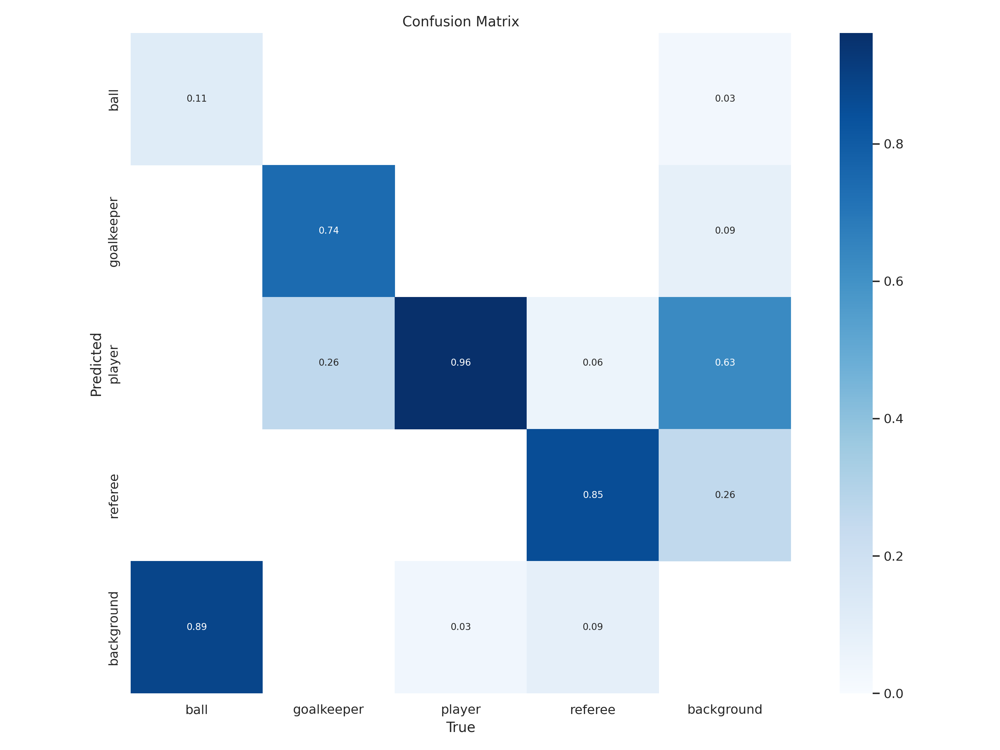

In [ ]:
%cd {HOME}
Image(filename=f'{HOME}/runs/detect/train/confusion_matrix.png', width=600)

/content


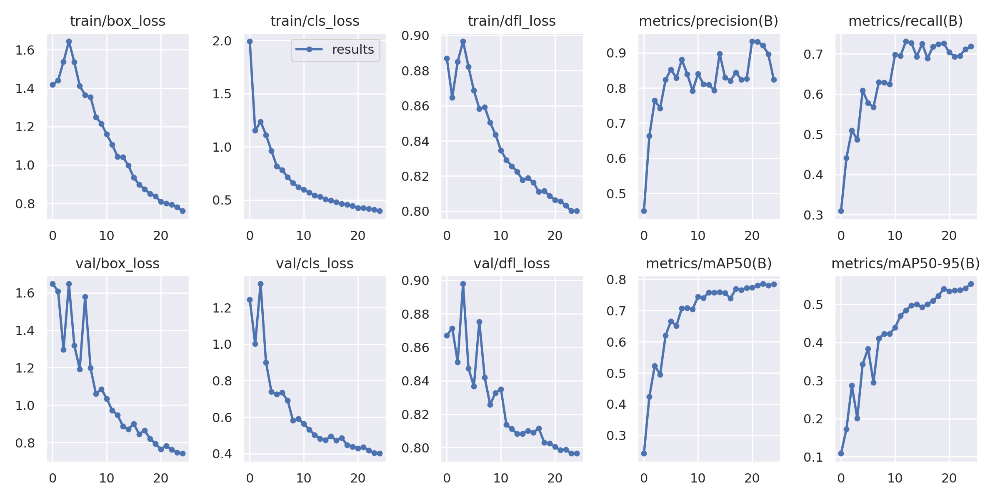

In [ ]:
%cd {HOME}
Image(filename=f'{HOME}/runs/detect/train/results.png', width=600)

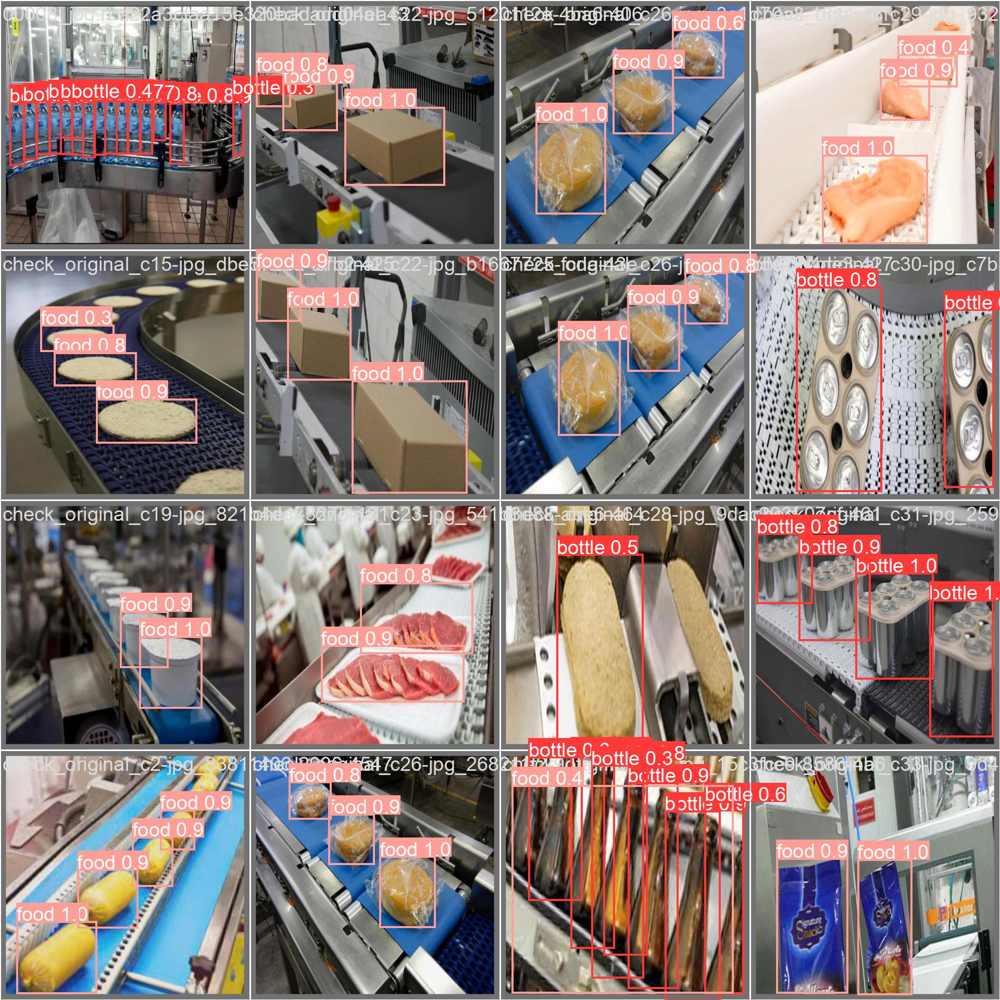

In [ ]:

Image(filename=f'/content/datasets/runs/detect/train2/val_batch0_pred.jpg', width=600)

## Validate the Custom Model

In [ ]:
!yolo task=detect mode=val model=/content/drive/MyDrive/convoyer_belt_data/out/train/weights/best.pt data=/content/datasets/data.yaml

Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 11126358 parameters, 0 gradients, 28.4 GFLOPs
100% 755k/755k [00:00<00:00, 16.6MB/s]
val: Scanning /content/datasets/valid/labels... 28 images, 0 backgrounds, 0 corrupt: 100% 28/28 [00:00<00:00, 304.48it/s]
val: New cache created: /content/datasets/valid/labels.cache
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0% 0/2 [00:00<?, ?it/s]WARNING ⚠️ NMS time limit 1.300s exceeded
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 2/2 [00:06<00:00,  3.15s/it]
                   all         28        239      0.805       0.36      0.421      0.302
       

## copy and save trained model and parameters  to drive

In [ ]:
!cp -r /content/datasets/runs/detect/train /content/drive/MyDrive/convoyer_belt_data/out

In [ ]:
!cp -r /content/datasets/runs/detect/predict /content/drive/MyDrive/convoyer_belt_data/res

## Inference with Custom Model

In [ ]:
!yolo task=detect mode=predict model=/content/drive/MyDrive/convoyer_belt_data/out/train/weights/best.pt conf=0.30 source=/content/ok.mp4 save=True

Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 11126358 parameters, 0 gradients, 28.4 GFLOPs

WARNING ⚠️ NMS time limit 0.550s exceeded
video 1/1 (1/1357) /content/acca.mp4: 384x640 2 foods, 115.5ms
video 1/1 (2/1357) /content/acca.mp4: 384x640 2 foods, 10.8ms
video 1/1 (3/1357) /content/acca.mp4: 384x640 2 foods, 10.8ms
video 1/1 (4/1357) /content/acca.mp4: 384x640 2 foods, 10.7ms
video 1/1 (5/1357) /content/acca.mp4: 384x640 2 foods, 10.7ms
video 1/1 (6/1357) /content/acca.mp4: 384x640 2 foods, 10.7ms
video 1/1 (7/1357) /content/acca.mp4: 384x640 2 foods, 10.7ms
video 1/1 (8/1357) /content/acca.mp4: 384x640 2 foods, 10.7ms
video 1/1 (9/1357) /content/acca.mp4: 384x640 2 foods, 10.7ms
video 1/1 (10/1357) /content/acca.mp4: 384x640 3 foods, 10.7ms
video 1/1 (11/1357) /content/acca.mp4: 384x640 3 foods, 10.7ms
video 1/1 (12/1357) /content/acca.mp4: 384x640 3 foods, 10.7ms
video 1/1 (13/1357) /content/acca.mp4: 3

In [ ]:
!yolo task=detect mode=predict model=/content/drive/MyDrive/convoyer_belt_data/out/train/weights/best.pt conf=0.45 source=/content/datasets/test/images save=True

Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 11126358 parameters, 0 gradients, 28.4 GFLOPs

image 1/14 /content/datasets/test/images/00034_jpg.rf.3941bc3857a119fc66496f9ce7e255bd.jpg: 640x640 13 bottles, 16.3ms
image 2/14 /content/datasets/test/images/00063_jpg.rf.d01f7e143687d53ece98c66b26810f49.jpg: 640x640 11 bottles, 16.3ms
image 3/14 /content/datasets/test/images/00076_jpg.rf.3202f329a37ab5bc9ab6d057a99301e6.jpg: 640x640 13 bottles, 16.3ms
image 4/14 /content/datasets/test/images/c25_jpg.rf.0efe50b567016416c01838b287be5708.jpg: 640x640 3 foods, 16.3ms
image 5/14 /content/datasets/test/images/c29_jpg.rf.c1bf626d765943823cea3b7ae24bb00a.jpg: 640x640 2 foods, 16.3ms
image 6/14 /content/datasets/test/images/c32_jpg.rf.660e348412688fb7345803cc5e64c4c5.jpg: 640x640 3 foods, 16.3ms
image 7/14 /content/datasets/test/images/check_original_c1-jpg_42e05e94-1bdc-4a15-81fa-ca9747c8d016_jpg.rf.0f59d1e4928c84e7a3a7a174

# **NOTE:** Let's take a look at few results.

In [1]:
!ffmpeg -i /content/ok.avi output.mp4

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

In [2]:
from IPython.display import HTML
from base64 import b64encode
mp4 = open('/content/output.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()

In [3]:
HTML("""
<video controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

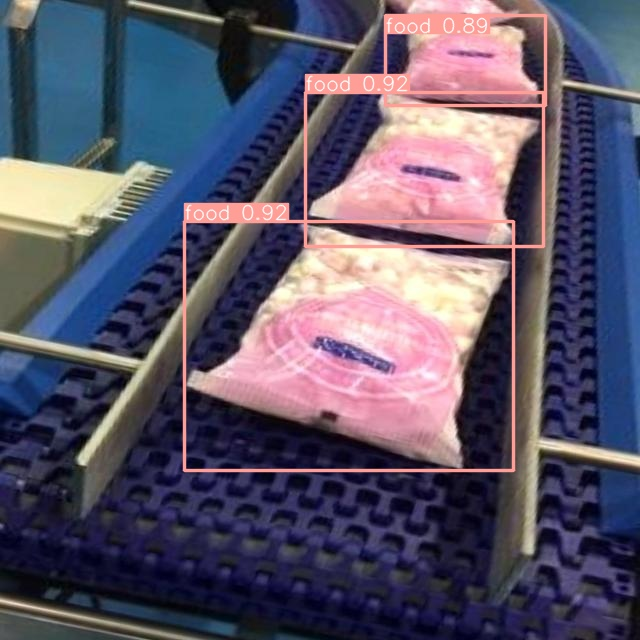

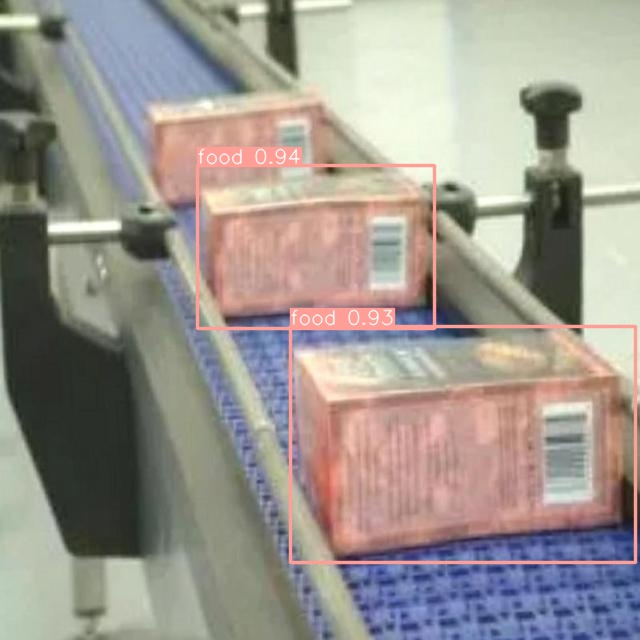

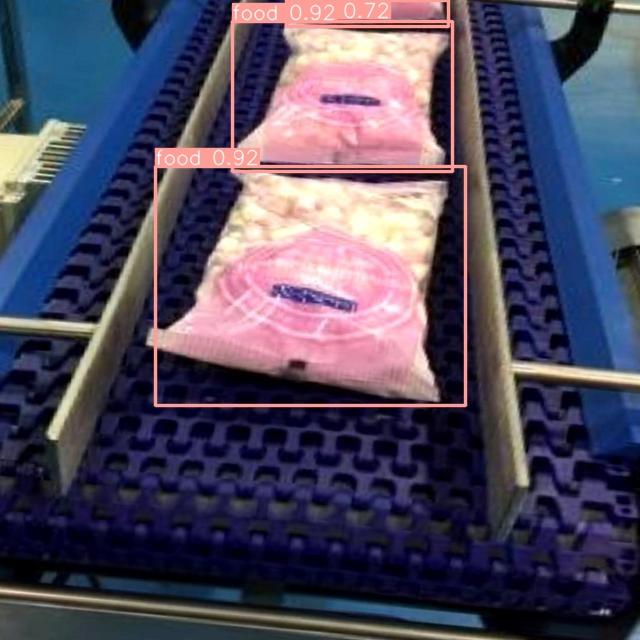

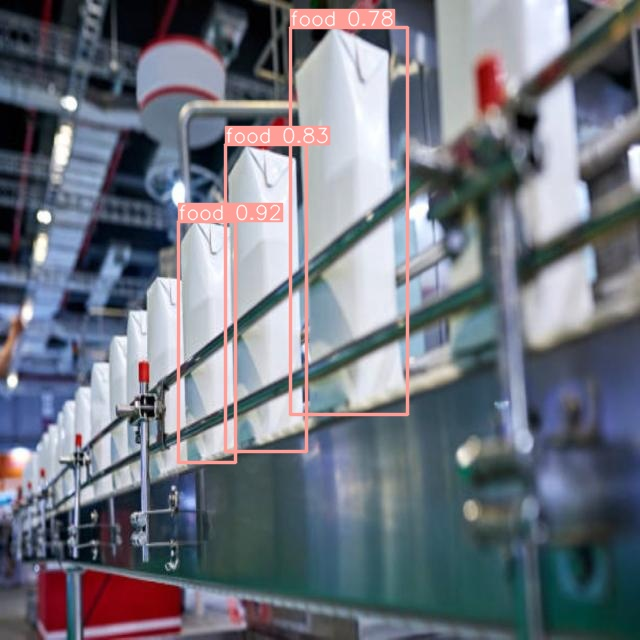

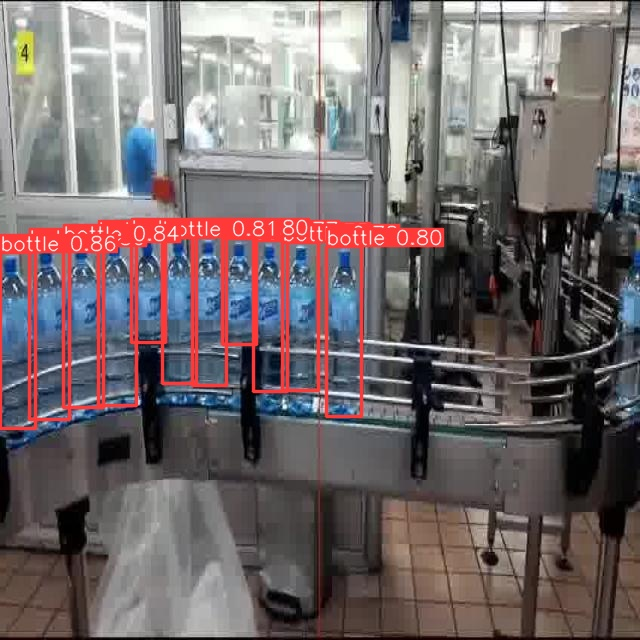

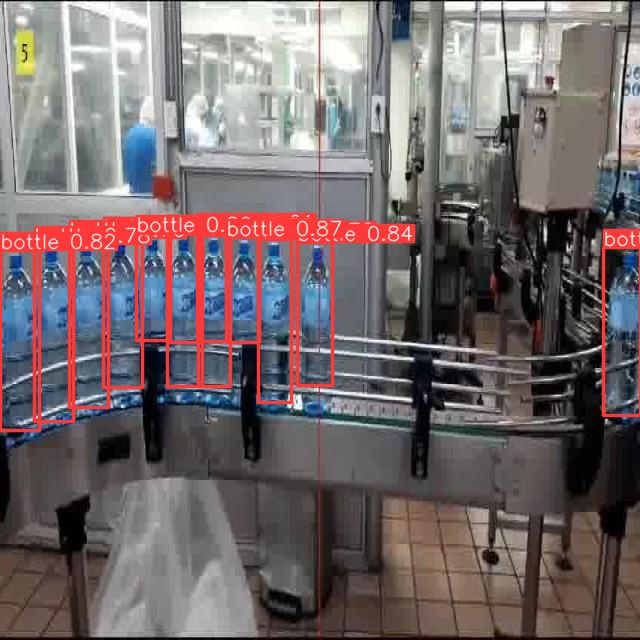

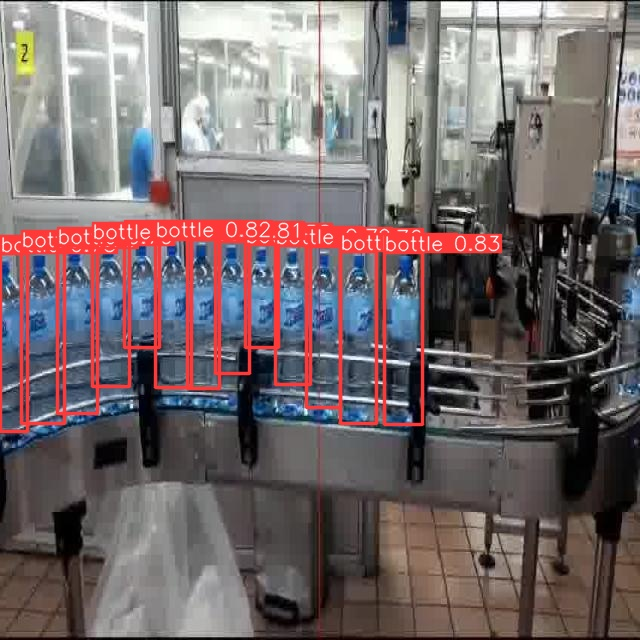

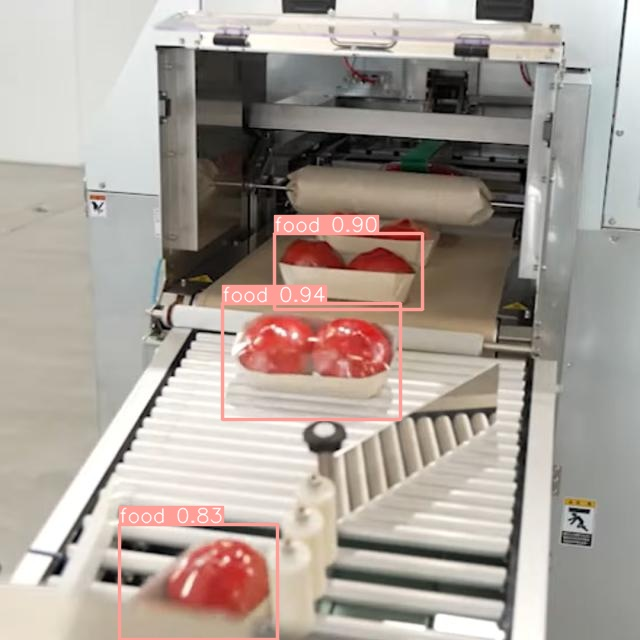

In [ ]:
import glob
from IPython.display import Image, display

for image_path in glob.glob(f'runs/detect/predict/*.jpg')[:8]:
      display(Image(filename=image_path, width=600))
      print("\n")